# Projet 1

In [41]:
import numpy as np
import pylab
import healpy as hp
import pysm3 
import pysm3.units as u
import matplotlib.pyplot as py
import cmbdb as cmb
from fgbuster import *
from fgbuster.mixingmatrix import MixingMatrix

In [42]:
NSIDE = 64
lmax = 3*NSIDE-1
print(lmax)
amin2rad = np.pi/(60.*180.)
print(amin2rad)

191
0.0002908882086657216


### LiteBIRD instrument

In [43]:
instrument = get_instrument('LiteBIRD')
fwhm = instrument.fwhm*amin2rad
freq = instrument.frequency
fwhm_common = 80*amin2rad
print(fwhm.shape)
print(freq)


(15,)
0      40.0
1      50.0
2      60.0
3      68.0
4      78.0
5      89.0
6     100.0
7     119.0
8     140.0
9     166.0
10    195.0
11    235.0
12    280.0
13    337.0
14    402.0
Name: frequency, dtype: float64


## Beam

In [44]:
beam_array = np.array([hp.gauss_beam(f,lmax = lmax, pol=True) for f in fwhm])
print(beam_array.shape)
num_freq, num_l, num_stokes = beam_array.shape


(15, 192, 4)


In [45]:
print((lmax+1)**2/2)

18432.0


In [46]:
ell_em = hp.Alm.getlm(lmax, np.arange(18528))[0]
print(ell_em.shape)
ell_em_mat = np.stack((ell_em, ell_em), axis=-1).reshape(-1) # For transformation into real alms
print(ell_em_mat)

(18528,)
[  0   0   1   1   2   2   3   3   4   4   5   5   6   6   7   7   8   8
   9   9  10  10  11  11  12  12  13  13  14  14  15  15  16  16  17  17
  18  18  19  19  20  20  21  21  22  22  23  23  24  24  25  25  26  26
  27  27  28  28  29  29  30  30  31  31  32  32  33  33  34  34  35  35
  36  36  37  37  38  38  39  39  40  40  41  41  42  42  43  43  44  44
  45  45  46  46  47  47  48  48  49  49  50  50  51  51  52  52  53  53
  54  54  55  55  56  56  57  57  58  58  59  59  60  60  61  61  62  62
  63  63  64  64  65  65  66  66  67  67  68  68  69  69  70  70  71  71
  72  72  73  73  74  74  75  75  76  76  77  77  78  78  79  79  80  80
  81  81  82  82  83  83  84  84  85  85  86  86  87  87  88  88  89  89
  90  90  91  91  92  92  93  93  94  94  95  95  96  96  97  97  98  98
  99  99 100 100 101 101 102 102 103 103 104 104 105 105 106 106 107 107
 108 108 109 109 110 110 111 111 112 112 113 113 114 114 115 115 116 116
 117 117 118 118 119 119 120 120 121 121 1

In [47]:
n_alm = np.size(ell_em_mat)
print(n_alm)

37056


In [48]:
print(beam_array[:,ell_em_mat,:])

[[[1.         1.0001517  1.0001517  1.00007585]
  [1.         1.0001517  1.0001517  1.00007585]
  [0.99992416 1.00007585 1.00007585 1.        ]
  [0.99992416 1.00007585 1.00007585 1.        ]
  [0.9997725  0.99992416 0.99992416 0.99984833]
  [0.9997725  0.99992416 0.99992416 0.99984833]
  [0.99954505 0.99969667 0.99969667 0.99962086]
  [0.99954505 0.99969667 0.99969667 0.99962086]
  [0.99924186 0.99939344 0.99939344 0.99931765]
  [0.99924186 0.99939344 0.99939344 0.99931765]
  [0.998863   0.99901453 0.99901453 0.99893876]
  [0.998863   0.99901453 0.99901453 0.99893876]
  [0.99840857 0.99856002 0.99856002 0.99848429]
  [0.99840857 0.99856002 0.99856002 0.99848429]
  [0.99787865 0.99803003 0.99803003 0.99795434]
  [0.99787865 0.99803003 0.99803003 0.99795434]
  [0.99727338 0.99742466 0.99742466 0.99734902]
  [0.99727338 0.99742466 0.99742466 0.99734902]
  [0.99659289 0.99674407 0.99674407 0.99666847]
  [0.99659289 0.99674407 0.99674407 0.99666847]
  [0.99583733 0.99598839 0.99598839 0.99

In [49]:
beam_array_lm = beam_array[:,ell_em_mat,:]

$\mathbf{A}$ is a $n_{comp}\times n_{freq}$ matrix.

$\mathbf{N}_p^{-1}$ is a $n_{freq}\times n_{freq}$ matrix.

$\mathbf{d}_{lm}$ and $\mathbf{s}_{lm}$ are $n_{comp}$ column vectors.


The beam B is suppoed axi-symmetric and gaussian, so it only depend on $\ell$. We construct the diagonal that we'll multiply with the mixing matrix.

\begin{equation}
\mathbf{As}_{lm} = 
\overbrace{\left [
\begin{array}{c|c}
A_{CMB} &
A_{fg} 
\end{array}
\right  ]}^{n_{stokes}\times n_{freq}} \times \overbrace{\left [\begin{array}{ccc}
s_{lm}^{CMB} \\ 
\hline 
s_{lm}^{fg} 
\end{array}
\right  ]}^{n_{stokes}}
\end{equation}



\begin{equation}
\mathbf{As}_{lm} = 
\overbrace{\left [
\begin{array}{cc}
\delta_{lm}^{\nu_1} \\ .\\.\\.\\
\delta_{lm}^{\nu_{n_{freq}}}
\end{array}
\right  ]}^{n_{freq}} 
\end{equation}

\begin{equation}
\mathbf{\tilde{A}}_{\ell} \mathbf{s}_{\ell m} = 
\overbrace{\left [
\begin{array}{cc}
b_{\ell}^{\nu_1}\delta_{lm}^{\nu_1} \\ .\\.\\.\\
b_{\ell}^{\nu_{n_{freq}}}\delta_{lm}^{\nu_{n_{freq}}}
\end{array}
\right  ]}^{n_{freq}} 
\end{equation} 

\begin{equation}
\mathbf{\tilde{A}}_{\ell} = \begin{bmatrix}
b_{\ell}^{\nu_1}  & \dots & 0 \\
\vdots & \ddots & \vdots \\
0 & \dots &  b_{\ell}^{\nu_{n_{freq}}} \\
\end{bmatrix} \times \mathbf{A}
\end{equation}


In [50]:
beam_diag = np.array([[np.diag(beam_array[:,i,j]) for i in range(0,num_l)]for j in range(0,num_stokes)])
print(beam_diag.shape)
print(np.diag(beam_diag[3][40]).shape)

(4, 192, 15, 15)
(15,)


In [51]:
beam_diag_lm = np.array([[np.diag(beam_array_lm[:,i,j]) for i in range(0,n_alm)]for j in range(0,num_stokes)])
print(beam_diag_lm.shape)
# print(np.diag(beam_diag[3][40]).shape)

(4, 37056, 15, 15)


In [52]:
print(beam_diag_lm.shape[:-2])
beam_diag_lm.shape[:-2]


(4, 37056)


(4, 37056)

### Mixing matrix

In [53]:
components = [CMB(), Dust(353.), Synchrotron(23.)]
# The starting point of the fit is the ax1sm default value, so let's shift it
components[1].defaults = [1.54, 20.]
components[2].defaults = [-3.0]
A = MixingMatrix(*components)
A_ev = A.evaluator(instrument.frequency)
i_cmb = A.components.index('CMB')

In [54]:
A.params

['Dust.beta_d', 'Dust.temp', 'Synchrotron.beta_pl']

In [55]:
# A_0 = A.eval(nu=instrument.frequency)

In [56]:
print(type(A_ev))
print(type(A_ev))

<class 'function'>
<class 'function'>


In [57]:
print(beam_diag_lm[-2][-1].shape)

(15, 15)


In [58]:
x0 = np.array([x for c in components for x in c.defaults])
print(x0)
A_x0 = A.eval(instrument.frequency,*x0)
# A_x0_beam = A.eval_beam(instrument.frequency,beam=beam_diag_lm,*x0)
print(A_x0)
# print(A_x0_beam)

[ 1.54 20.   -3.  ]
[[1.         0.00423196 0.1954143 ]
 [1.         0.00603215 0.10238125]
 [1.         0.00811409 0.06092987]
 [1.         0.00999838 0.04295475]
 [1.         0.01265541 0.02952581]
 [1.         0.01601375 0.02080753]
 [1.         0.0198976  0.01544213]
 [1.         0.02810785 0.01014108]
 [1.         0.0400235  0.00708993]
 [1.         0.06051774 0.00511346]
 [1.         0.09436441 0.00398449]
 [1.         0.17191744 0.00327809]
 [1.         0.33594939 0.00306883]
 [1.         0.78671538 0.00334585]
 [1.         2.09132434 0.0043669 ]]


In [59]:

# Assuming you have an N-dimensional array 'arr' with shape (d1, d2, ..., dn, n, n)
# And a matrix 'matrix' with shape (n, m)
(n,m) = A_x0.shape
# Get the shape of the N-2 first dimensions
shape_n_minus_2 = beam_diag_lm.shape[:-2]

# Reshape the array 'arr' and the matrix 'matrix' for matrix multiplication
arr_reshaped = np.reshape(beam_diag_lm, shape_n_minus_2 + (n, n))
matrix_reshaped = np.reshape(A_x0, (n, m))

# Perform the matrix product along the last two dimensions
result = np.einsum('...ij, jm -> ...im', arr_reshaped, matrix_reshaped)

# The resulting 'result' array will run on the N-2 first dimensions


In [60]:
print(result.shape)

(4, 37056, 15, 3)


In [61]:
(0,1)[0]

0

In [62]:
A_lm_beam = np.array([[np.matmul(np.diag(beam_array[:,i,j]),A_x0) for i in range(0,num_l)]for j in range(0,num_stokes)])
print(A_lm_beam.shape)

(4, 192, 15, 3)


In [63]:
A_x0_beam = A.eval_beam( instrument.frequency,beam_diag_lm,*x0)

In [64]:
print(A_x0_beam.shape)

(4, 37056, 15, 3)


# Simulating Sky

In [65]:

# sky_CMB = get_sky(NSIDE,'c1')
sky_d0s0 = get_sky(NSIDE, 'd0s0') 
# freq_maps_CMB = get_observation(instrument, sky_CMB)
freq_maps_d0s0 = get_observation(instrument,sky_d0s0)
num_freq,ncomp,npix = freq_maps_d0s0.shape
print(freq_maps_d0s0.shape)
alms_fgs = hp.map2alm(freq_maps_d0s0[0],lmax =lmax)  

print(alms_fgs.shape)

(15, 3, 49152)
(3, 18528)


In [66]:
np.set_printoptions(threshold=np.inf)
print(alms_fgs.shape)
ell_em = hp.Alm.getlm(lmax, np.arange(alms_fgs.shape[-1]))[0]
print(ell_em.shape)
ell_em_mat = np.stack((ell_em, ell_em), axis=-1).reshape(-1) # For transformation into real alms
print(ell_em_mat.shape)


    # Transform healpy complex alms into real alms
# alms_fgs = _format_alms(alms_fgs, lmin)

#     # Format the estimated inverse noise matrix
# if invNl is None:
#     invNl = harmonic_noise_cov(instrument, lmax)
#     invNl = np.array([[np.diag(invNl[:,st,l]) for st in np.arange(invNl.shape[1])] for l in np.arange(invNl.shape[2])])
# invNlm = np.array([invNl[l,1:,:,:] for l in ell_em]) # Here we take only polarization
# invNl = invNl[:,-1,:,:]

(3, 18528)
(18528,)
(37056,)


In [67]:
cl_CMB_th = hp.read_cl("/home/julientang2001/Stage3A/Cls_Planck2018_lensed_scalar.fits")
print(cl_CMB_th.shape)

cl_CMB_crop_th = cl_CMB_th[:,:lmax+1]
print(cl_CMB_crop_th.shape)

(4, 4001)
(4, 192)


(3, 49152)


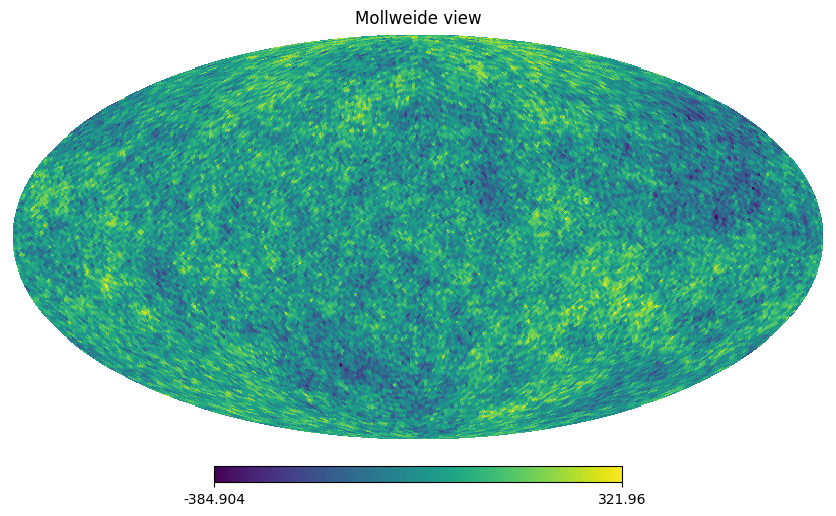

In [68]:
np.random.seed(0)
map_CMB = hp.synfast(cl_CMB_th,nside=NSIDE,new = True)

hp.mollview(map_CMB[0])


print(map_CMB.shape)

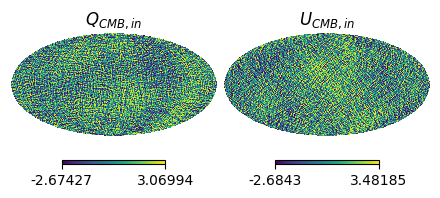

In [69]:
# hp.mollview(map_CMB[0], title='Input CMB', sub=(1,3,1))
hp.mollview(map_CMB[1], title='$Q_{CMB,in}$', norm='hist', sub=(1,3,2))
hp.mollview(map_CMB [2], title='$U_{CMB,in}$', norm='hist', sub=(1,3,3))

In [70]:
cl_CMB6 = hp.anafast(map_CMB,lmax=lmax,alm = False)
cl_CMB = cl_CMB6[:4]
print(cl_CMB.shape)
map_CMB_QU = np.zeros((2,npix),dtype=complex)
map_CMB_QU[0] = map_CMB[1]  # Q
map_CMB_QU[1] = map_CMB[2]  # Q
print(map_CMB_QU.shape)

(4, 192)
(2, 49152)


In [71]:
freq_maps_simple_noiseless = np.array([np.add(map_CMB,map_d0s0) for map_d0s0 in freq_maps_d0s0])
freq_map_noise = get_noise_realization(nside=NSIDE,instrument=instrument#,unit = 'uK_CMB'
                                       )



## Beam (check with hp.smoothing)

In [72]:

inv_beam_arr = 1/beam_array
fwhm_common = 80*amin2rad
beam_common = hp.gauss_beam(fwhm_common,lmax = lmax, pol = True)
b_c = np.array([beam_common*beam_inv for beam_inv in inv_beam_arr])
print(b_c.shape)

(15, 192, 4)


In [73]:
print(map_CMB.shape,beam_common.shape)

(3, 49152) (192, 4)


In [74]:
map_CMB_smooth = np.array([hp.smoothing(map_CMB[j,:],beam_window=beam_common[:,j]) for j in range(0,ncomp)])
print(map_CMB_smooth.shape)


(3, 49152)


In [75]:
map_CMB_smooth_QU = np.zeros((2,npix))
map_CMB_smooth_QU[0]=map_CMB_smooth[1]   
map_CMB_smooth_QU[1]=map_CMB_smooth[2]
print(map_CMB_smooth_QU.shape)

(2, 49152)


In [76]:
print(freq_maps_simple_noiseless[0,0].shape)
print(beam_array[0,0].shape)

(49152,)
(4,)


(2.0, 200.55)

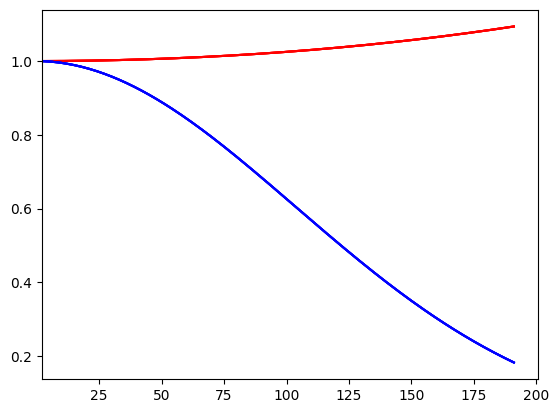

In [77]:
l_arr = np.arange(0,lmax+1,1)
py.figure()
ax1 = py.subplot(111)
ax1.plot(l_arr,inv_beam_arr[14],'r')
ax1.plot(l_arr,b_c[14],'b')
py.xlim(left = 2)

In [78]:
BAS_p_nl_smooth = np.array([np.array([hp.smoothing(freq_maps_simple_noiseless[i,j],beam_window=beam_array[i,:,j]) for j in range(0,ncomp) ]) for i in range(0,num_freq)])
print(BAS_p_nl_smooth.shape)

(15, 3, 49152)


In [79]:
# BAS_lm =np.array([hp.map2alm(BAS) for BAS in BAS_p_nl_smooth])
# freq_lm = np.array([hp.map2alm(map) for map in freq_maps_simple])
# inv_lm = BAS_lm/freq_lm
# Beam = BAS_p_nl_smooth/freq_maps_simple
# print(Beam.shape)
# print(Beam)
# Beam_lm2 =np.array([hp.map2alm(beam) for beam in Beam])
# print(Beam_lm.shape, Beam_lm2.shape)
# tt = np.linspace(0,len(Beam_lm[0,0]),len(Beam_lm[0,0]))
# py.plot(tt,Beam_lm[0,0],'r')
# py.plot(tt,Beam_lm2[0,0],'b')
# py.show()

In [81]:
BAS_p = np.add(BAS_p_nl_smooth,freq_map_noise)
BAS_QU_p = np.zeros((num_freq,2,npix))
BAS_QU_p[:,0,:]=BAS_p[:,1,:]
BAS_QU_p[:,1,:]=BAS_p[:,2,:]
print(BAS_QU_p.shape)

(15, 2, 49152)


In [18]:
# AS_p = np.array([hp.smoothing(BAS_p[i],fwhm=inv_fwhm[i]) for i in range(0,num_freq)])
AS_p_inv = np.array([np.array([hp.smoothing(BAS_p[i,j],beam_window=inv_beam_arr[i,:,j]) for j in range(0,ncomp) ]) for i in range(0,num_freq)])

AS_p_ren = np.array([np.array([hp.smoothing(BAS_p[i,j],beam_window=b_c[i,:,j]) for j in range(0,ncomp) ]) for i in range(0,num_freq)])

In [19]:
AS1_QU_p = np.zeros((num_freq,2,npix))
AS1_QU_p[:,0,:]=AS_p_inv[:,1,:]
AS1_QU_p[:,1,:]=AS_p_inv[:,2,:]
print(AS1_QU_p.shape)

(15, 2, 49152)


In [20]:
BAS_QU_p = np.zeros((num_freq,2,npix))
BAS_QU_p[:,0,:]=BAS_p[:,1,:]
BAS_QU_p[:,1,:]=BAS_p[:,2,:]
print(BAS_QU_p.shape)

(15, 2, 49152)


In [21]:
AS2_QU_p = np.zeros((num_freq,2,npix))
AS2_QU_p[:,0,:]=AS_p_ren[:,1,:]
AS2_QU_p[:,1,:]=AS_p_ren[:,2,:]
print(AS2_QU_p.shape)

(15, 2, 49152)


## Component separation

In [82]:
components = [CMB(), Dust(353.), Synchrotron(23.)]
# The starting point of the fit is the ax1sm default value, so let's shift it
components[1].defaults = [1.54, 20.]
components[2].defaults = [-3.0]
A = MixingMatrix(*components)
A_ev = A.evaluator(instrument.frequency)
i_cmb = A.components.index('CMB')

In [85]:
result_harmonic = harmonic_comp_sep(components,instrument,BAS_p,NSIDE,lmax)

Computing alms


/home/julientang2001/fgbuster/fgbuster/mixingmatrix.py:117: FutureWarning: Support for multi-dimensional indexing (e.g. `obj[:, None]`) is deprecated and will be removed in a future version.  Convert to a numpy array before indexing instead.
  def f():
/home/julientang2001/fgbuster/fgbuster/algebra.py:1079: RuntimeWarning: invalid value encountered in divide
  res.chi_dB.append(np.sum(res.chi * As_dB_i, -1)


In [87]:
print(result_harmonic.s.shape)

(3, 2, 18528)


In [88]:
result_harmonic_beam = harmonic_comp_sep_beam(components,instrument,BAS_p,NSIDE,lmax)

NameError: name 'harmonic_comp_sep_beam' is not defined

In [25]:

result_beam_inv= basic_comp_sep(components, instrument, AS1_QU_p, # verbose output                        
                       )
print(result_beam_inv.s.shape)

A_beam_inv = A_ev(result_beam_inv.x)

print(A_beam_inv.shape)
result_beam_ren = basic_comp_sep(components, instrument, AS2_QU_p, # verbose output             
                               )
A_beam_ren = A_ev(result_beam_ren.x)

print(A_beam_ren.shape)

(3, 2, 49152)
(15, 3)
(15, 3)


In [26]:

result_no_beam= basic_comp_sep(components, instrument, BAS_QU_p, # verbose output                        
                       )
print(result_no_beam.s.shape)

A_no_beam = A_ev(result_no_beam.x)

(3, 2, 49152)


### Get noise

In [27]:
def _get_Cl_noise_nofwhm(instrument,beam, A, lmax):
    nl = (beam / np.radians(instrument.depth_p/60.)[:, np.newaxis])**2
    AtNA = np.einsum('fi, fl, fj -> lij', A, nl, A)
    inv_AtNA = np.linalg.inv(AtNA)
    return inv_AtNA.swapaxes(-3, -1)

In [28]:
cl_beam_inv =_get_Cl_noise_nofwhm(instrument=instrument,beam = inv_beam_arr[:,:,0] ,A = A_beam_inv,lmax=lmax)[i_cmb, i_cmb, :]
cl_beam_ren =_get_Cl_noise_nofwhm(instrument=instrument,beam = b_c[:,:,0], A = A_beam_ren,lmax=lmax)[i_cmb, i_cmb, :]
print(cl_beam_ren.shape)
# cl_CMB_BB_bn = cl_beam_noise[0,2,:]
# cl_CMB_BB_renn = cl_ren_noise[0,2,:]

# print(cl_CMB_BB_bn.shape, cl_CMB_BB_renn.shape)

(192,)


/tmp/ipykernel_226/1937513622.py:2: FutureWarning: Support for multi-dimensional indexing (e.g. `obj[:, None]`) is deprecated and will be removed in a future version.  Convert to a numpy array before indexing instead.
  nl = (beam / np.radians(instrument.depth_p/60.)[:, np.newaxis])**2


In [29]:
inputs = [sky_d0s0.components[0].mbb_index,
          sky_d0s0.components[0].mbb_temperature.value,
          sky_d0s0.components[1].pl_index]
print("%-20s\t%s\t%s" % ('', 'Estimated', 'Input'))

for param, val, ref in zip(result_beam_inv.params, result_beam_inv.x, inputs):
    print("%-20s\t%f\t%f" % (param, val, ref))

print("%-20s\t%s\t%s" % ('', 'Estimated', 'Input'))
for param, val, ref in zip(result_beam_ren.params, result_beam_ren.x, inputs):
    print("%-20s\t%f\t%f" % (param, val, ref))

                    	Estimated	Input
Dust.beta_d         	1.545836	1.540000
Dust.temp           	19.808758	20.000000
Synchrotron.beta_pl 	-3.042165	-3.000000
                    	Estimated	Input
Dust.beta_d         	1.540887	1.540000
Dust.temp           	19.971752	20.000000
Synchrotron.beta_pl 	-3.004694	-3.000000


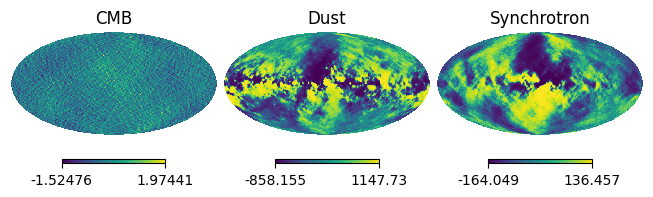

In [30]:
hp.mollview(result_beam_ren.s[0,1], title='CMB', sub=(1,3,1))
hp.mollview(result_beam_ren.s[1,1], title='Dust', norm='hist', sub=(1,3,2))
hp.mollview(result_beam_ren.s[2,1], title='Synchrotron', norm='hist', sub=(1,3,3))


# Residuals

In [31]:
res_CMB_Q_inv = np.subtract(result_beam_inv.s[0,0], map_CMB_QU[0])#noisy
res_CMB_U_inv = np.subtract(result_beam_inv.s[0,1], map_CMB_QU[1])
res_CMB_Q_ren = np.subtract(result_beam_ren.s[0,0], map_CMB_smooth_QU[0])
res_CMB_U_ren = np.subtract(result_beam_ren.s[0,1], map_CMB_smooth_QU[1])
print(res_CMB_Q_inv.shape,res_CMB_U_ren.shape)

(49152,) (49152,)


In [32]:
res_CMB_inv= np.zeros((3,npix),dtype=complex)
res_CMB_inv[1] = res_CMB_Q_inv
res_CMB_inv[2] = res_CMB_U_inv
print(res_CMB_inv.shape)

(3, 49152)


In [33]:
res_CMB_ren= np.zeros((3,npix),dtype=complex)
res_CMB_ren[1] = res_CMB_Q_ren
res_CMB_ren[2] = res_CMB_U_ren
print(res_CMB_ren.shape)

(3, 49152)


In [34]:
C_l_CMB_inv=hp.anafast(res_CMB_inv,lmax = lmax,alm=False,pol=True)
C_l_CMB_ren =hp.anafast(res_CMB_ren,lmax=lmax,alm=False,pol=True)
print(C_l_CMB_inv.shape)

(6, 192)


/home/julientang2001/.local/lib/python3.10/site-packages/healpy/sphtfunc.py:274: ComplexWarning: Casting complex values to real discards the imaginary part
  alms = _sphtools.map2alm(


In [35]:
C_EE_CMB_inv_l = C_l_CMB_inv[1]
C_BB_CMB_inv_l = C_l_CMB_inv[2]
C_EE_CMB_ren_l = C_l_CMB_ren[1]
C_BB_CMB_ren_l = C_l_CMB_ren[2]
print(C_EE_CMB_inv_l.shape)
print(C_BB_CMB_ren_l.shape)

(192,)
(192,)


### Retrieved CMB Power spectrum

In [36]:
res_ret_inv = np.zeros((3,npix),dtype=complex)
res_ret_inv[1] = result_beam_inv.s[0,0]
res_ret_inv[2] = result_beam_inv.s[0,1]
print(res_ret_inv.shape)
res_ret_ren = np.zeros((3,npix),dtype=complex)
res_ret_ren[1] = result_beam_ren.s[0,0]
res_ret_ren[2] = result_beam_ren.s[0,1]


(3, 49152)


In [37]:
C_L_ret_ren = hp.anafast(res_ret_ren,alm = False,pol=True)
print(C_L_ret_ren.shape)
C_l_ret_ren_BB = C_L_ret_ren[2]
print(C_l_ret_ren_BB.shape)
C_L_inv = hp.anafast(res_ret_inv,alm = False,pol=True)
print(C_L_inv.shape)
C_l_inv_BB = C_L_inv[2]
print(C_l_inv_BB.shape)

(6, 192)
(192,)
(6, 192)
(192,)


# + Gravitational waves

In [38]:
cl_GW = hp.read_cl("/home/julientang2001/Stage3A/Cls_Planck2018_unlensed_scalar_and_tensor_r1.fits")
print(cl_GW.shape)
cl_GW_crop = cl_GW[:,:lmax+1]
print(cl_GW_crop.shape)

map_CMB = hp.synfast(cl_GW,nside=NSIDE)

(4, 4101)
(4, 192)


In [39]:
cl_tot_th = np.add(0.001*cl_GW_crop,cl_CMB)

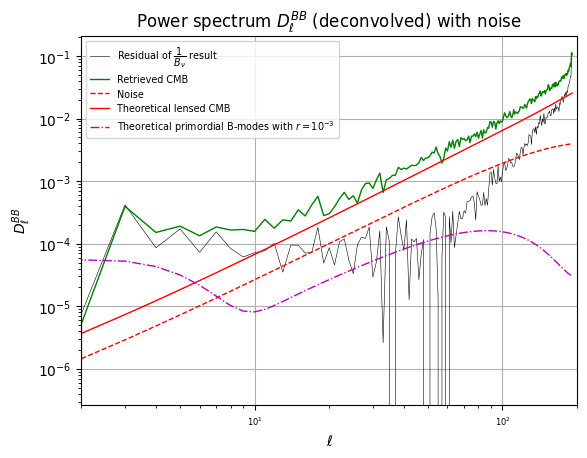

In [40]:
l_arr = np.arange(0,lmax+1,1)

py.figure(1)
ax1 = py.subplot(111)
ax1.tick_params('x', labelsize=6)
ax1.plot(l_arr,l_arr*(l_arr+1)/np.pi*np.subtract(C_BB_CMB_inv_l,cl_beam_inv),'k',linewidth =.4,label = 'Residual of $\dfrac{1}{B_{\\nu}}$ result')
ax1.plot(l_arr,l_arr*(l_arr+1)/np.pi*C_l_inv_BB,'g',linewidth = 1,label = 'Retrieved CMB')
ax1.plot(l_arr,l_arr*(l_arr+1)/np.pi*cl_beam_inv,'r--',linewidth =1, label = 'Noise')
ax1.plot(l_arr,l_arr*(l_arr+1)/np.pi*cl_CMB_crop_th[2],'r-',linewidth =1,label = "Theoretical lensed CMB")
py.title('Power spectrum $D_{\ell}^{BB}$ (deconvolved) with noise')

# ax1.plot(l_arr,l_arr*(l_arr+1)*C_l_ret_ren_BB/np.pi,'g',linewidth = 1,label = 'Retrieved CMB')
# ax1.plot(l_arr,l_arr*(l_arr+1)*C_BB_CMB_ren_l/np.pi,'k',linewidth =.4,label = 'Residual of $\dfrac{B_c}{B_{\\nu}}$ result')
# ax1.plot(l_arr,l_arr*(l_arr+1)/np.pi*cl_beam_ren,'r--',linewidth =1, label = 'Noise')
# ax1.plot(l_arr,l_arr*(l_arr+1)*cl_CMB_crop_th[2]*beam_common[:,2]**2/np.pi,'r-',linewidth =1,label = "Theoretical lensed CMB (beamed)")
# py.title('Power spectrum $D_{\ell}^{BB}$ (re and de-convolved) with noise')
# ax1.plot(l_arr,l_arr*(l_arr+1)/np.pi*cl_CMB_crop_th[2],'b-.',linewidth =1,label = "Theoretical lensed CMB (beamed) ")
#         #  $D_{\ell,lens}^{BB}$")
ax1.plot(l_arr,l_arr*(l_arr+1)/np.pi*0.001*cl_GW_crop[2],'m-.',linewidth =1,label = "Theoretical primordial B-modes with $r=10^{-3}$")
# #         # $D_{\ell,GW}^{BB}$")


handles, labels = ax1.get_legend_handles_labels()
py.xlim(left = 2)
py.grid()
py.xlabel('$\ell$')
py.yscale("log")
py.xscale("log")
# py.ylim(-1,1)

        #  of the residuals with and without beam, with noise')

py.ylabel('$D_{\ell}^{BB}$')
py.legend(handles,labels, loc = 'upper left', fontsize = 'x-small')
py.show()

In [41]:
print(np.subtract(C_BB_CMB_ren_l,cl_beam_ren))

[-7.75968812e-07 -7.76083045e-07 -4.55126086e-07  2.02560259e-06
 -1.57998049e-07  2.76683612e-07 -2.54258016e-07  5.73768554e-08
  3.90061454e-08 -4.46456426e-07  1.42940830e-07 -2.87283401e-07
  1.18672885e-07 -3.31198872e-07 -1.15551613e-07 -4.85642466e-09
 -3.61548664e-07 -7.84254431e-08  1.61091122e-07 -3.86636524e-08
 -1.87025121e-07 -1.82101233e-07 -7.69768677e-08  6.90481591e-08
 -1.21950163e-07 -2.88740993e-07 -2.98432795e-08 -1.75865998e-08
  3.07767481e-08  7.59138803e-09 -5.19912121e-08 -1.42711214e-07
  6.56688460e-08 -2.69012791e-07  5.67627372e-08 -1.36669337e-07
 -4.03030283e-07 -1.32418303e-07  1.42153390e-07 -1.18175489e-07
 -2.44426846e-07 -1.55553975e-07 -2.68505089e-07 -2.71061168e-07
 -2.25328326e-07 -2.20037455e-07 -3.44359976e-07 -2.56602903e-07
 -2.91722257e-07 -3.73782484e-07 -4.28447415e-07 -2.50149601e-07
 -2.10199591e-07 -2.29518006e-07 -3.02794382e-07 -4.72714391e-07
 -4.95129560e-07 -4.75466890e-07 -2.80185491e-07 -3.69854309e-07
 -5.66046403e-07 -3.88409

# Cosmological parameters

In [42]:
def cosmo_likelihood(r,C_l_obs,noise):
    if len(C_l_obs)!=lmax+1 or len(noise)!=lmax+1:
        raise Warning("Arrays should be of size "+str(lmax))
    
    C_lth =r*cl_GW_crop[2]+cl_CMB_crop_th[2]+noise
    sig = 0
    for l in range(2,lmax):
        sig+=(2*l+1)*(np.log(C_lth[l])+C_l_obs[l]/C_lth[l])
    return (sig)


In [43]:
avg_cosmo_ren = cosmo_likelihood(r=0,C_l_obs=C_l_ret_ren_BB,noise=cl_beam_ren)
avg_cosmo_inv = cosmo_likelihood(r=0,C_l_obs=C_l_inv_BB,noise=cl_beam_inv)

print(avg_cosmo_ren)

-433139.56797413644


In [44]:
r_arr = np.logspace(-2.3,-2,100)
y_ren =np.array([cosmo_likelihood(r,C_l_obs=C_l_ret_ren_BB,noise=cl_beam_ren) for r in r_arr])
y_inv =np.array([cosmo_likelihood(r,C_l_obs=C_l_inv_BB,noise=cl_beam_inv) for r in r_arr])
y_inv0 = np.min(y_inv)

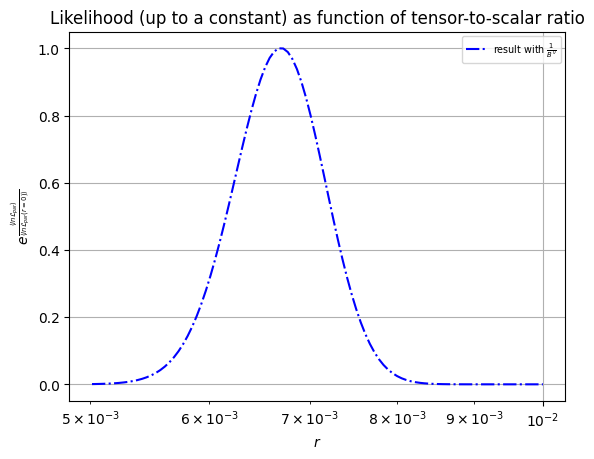

In [45]:
fig,ax = py.subplots()

# ax.plot(r_arr,np.exp((avg_cosmo_ren-y_ren)/2),'r-.', label = 'result with '+r'$\frac{B^c}{B^{\nu}}$')
ax.plot(r_arr,np.exp((y_inv0-y_inv)/2),'b-.',label = 'result with '+r'$\frac{1}{B^{\nu}}$')



py.title('Likelihood (up to a constant) as function of tensor-to-scalar ratio')
handles, labels = ax.get_legend_handles_labels()
py.xlabel(r'$r$')
py.ylabel(r'$e^{\frac{\langle ln \mathcal{L}_{par} \rangle}{\langle ln \mathcal{L}_{par}(r=0) \rangle}}$')

# py.ylabel(r'$e^{-1+\frac{\langle ln \mathcal{L}_{par} \rangle}{\langle ln \mathcal{L}_{par}(r=0) \rangle}}$')
# py.yscale("log")
py.xscale("log")
# py.xlim(0,1e-3)
py.grid()
# py.ylim(-1,1)

        #  of the residuals with and without beam, with noise')
# Set the background color of the plot
# ax.set_facecolor('gray')

# Set the background color of the figure
# ax.xaxis.label.set_color('white')
# ax.yaxis.label.set_color('white')
# ax.title.set_color('white')
# fig.set_facecolor('gray')

py.legend(handles,labels, loc = 'best', fontsize = 'x-small')
py.show()